In [107]:
import numpy as np
from IPython import get_ipython
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
mpl.rcParams['figure.dpi'] = 300

In [108]:
df = pd.DataFrame({
    'x': [810.45, 1350.75, 1891.05, 1215.675, 1958.5875, 2228.7375, 1620.9, 3039.1875, 3039.1875, 3511.95, 3444.4125, 3511.95, 3714.5625, 3579.4875, 3714.5625, 4119.7875, 4322.4, 4660.0875, 4862.7],
    'y': [1209.4875, 1116.45, 930.375, 1612.65, 1674.675, 1426.575, 1705.6875, 1829.7375, 1953.7875, 2170.875, 2046.825, 1953.7875, 1798.725, 713.2875, 434.175, 248.1, 589.2375, 217.0875, 744.3]
})


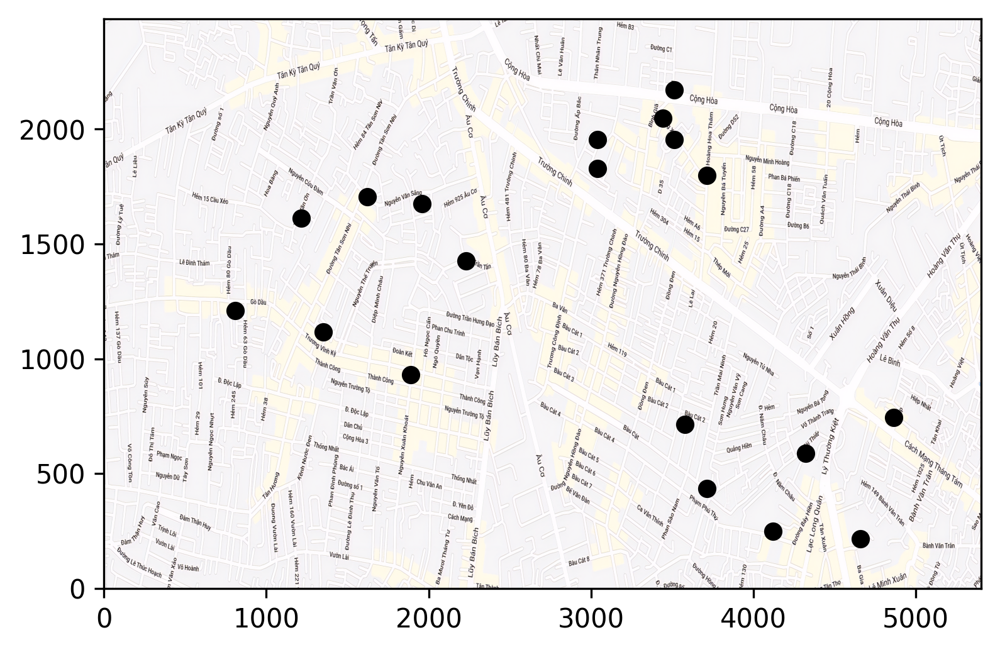

In [109]:
img = plt.imread("map.png")
fig, ax = plt.subplots()
ax.imshow(img, aspect='auto', extent=[0, 5403, 0, 2481])
plt.scatter(df['x'], df['y'], color='black')
plt.show()


In [110]:
np.random.seed(5)
k = 3
# centroids[i] = [x, y]
centroids = {
    i+1: [np.random.randint(0, 5403), np.random.randint(0, 2481)]
    for i in range(k)
}
centroids

{1: [2915, 2254], 2: [4079, 1725], 3: [3046, 1424]}

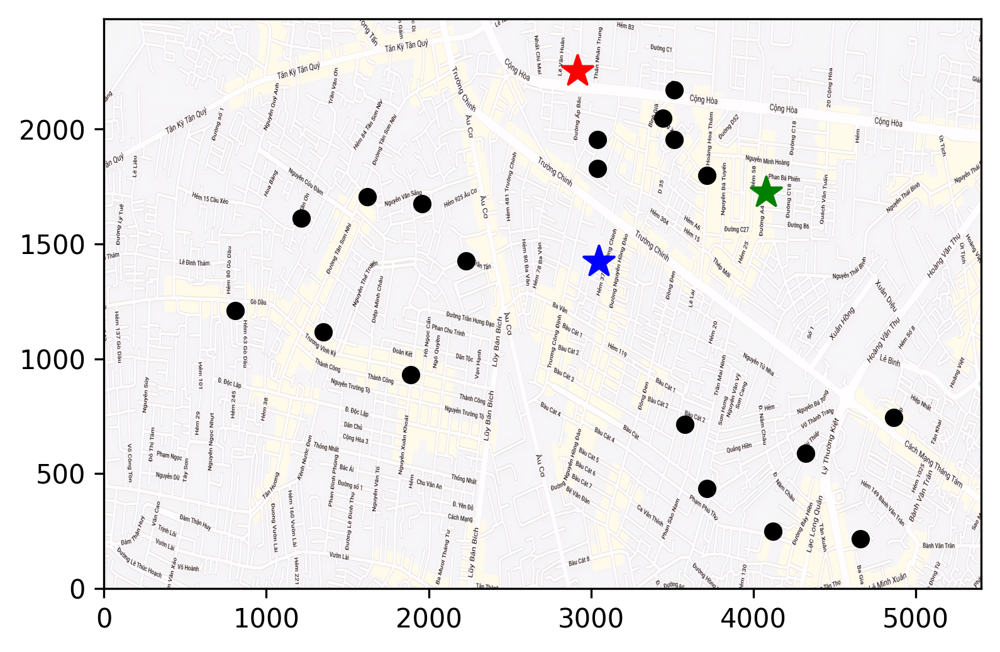

In [111]:
img = plt.imread("map.png")
fig, ax = plt.subplots()
ax.imshow(img, aspect='auto', extent=[0, 5403, 0, 2481])
plt.scatter(df['x'], df['y'], color='k')
colmap = {1: 'r', 2: 'g', 3: 'b'}

for i in centroids.keys():
    plt.scatter(*centroids[i], color = colmap[i], marker = "*", s = 150)

plt.show()


In [112]:
# Assignment stage

def ass(df, centroids):
    for i in centroids.keys():
        # sqrt((x1 - x2)^2 - (y1 - y2)^2)
        df['distance_from_{}'.format(i)] = (
            np.sqrt(
                (df['x'] - centroids[i][0]) ** 2 + 
                (df['y'] - centroids[i][1]) ** 2
            )
        )
    centroid_distance_cols = ['distance_from_{}'.format(i) for i in centroids.keys()]
    df['closest'] = df.loc[:, centroid_distance_cols].idxmin(axis = 1)
    df['closest'] = df['closest'].map(lambda x: int(x.lstrip('distance_from_')))
    df['color'] = df['closest'].map(lambda x: colmap[x])
    return df

df = ass(df, centroids)
df


,x,y,distance_from_1,distance_from_2,distance_from_3,closest,color
0,810.4500,1209.4875,2349.497194,3308.953345,2245.818206,3,b
1,1350.7500,1116.4500,1934.140136,2795.296257,1722.921810,3,b
2,1891.0500,930.3750,1673.456526,2327.778790,1256.015582,3,b
3,1215.6750,1612.6500,1816.324662,2865.528324,1840.021312,1,r
4,1958.5875,1674.6750,1118.187071,2121.009612,1115.931853,3,b
5,2228.7375,1426.5750,1074.982953,1874.174165,817.266557,3,b
6,1620.9000,1705.6875,1405.468394,2458.175865,1452.672660,1,r
7,3039.1875,1829.7375,442.064706,1045.074150,405.794688,3,b
8,3039.1875,1953.7875,324.884718,1064.684815,529.831299,1,r
9,3511.9500,2170.8750,602.709771,721.353047,880.302032,1,r


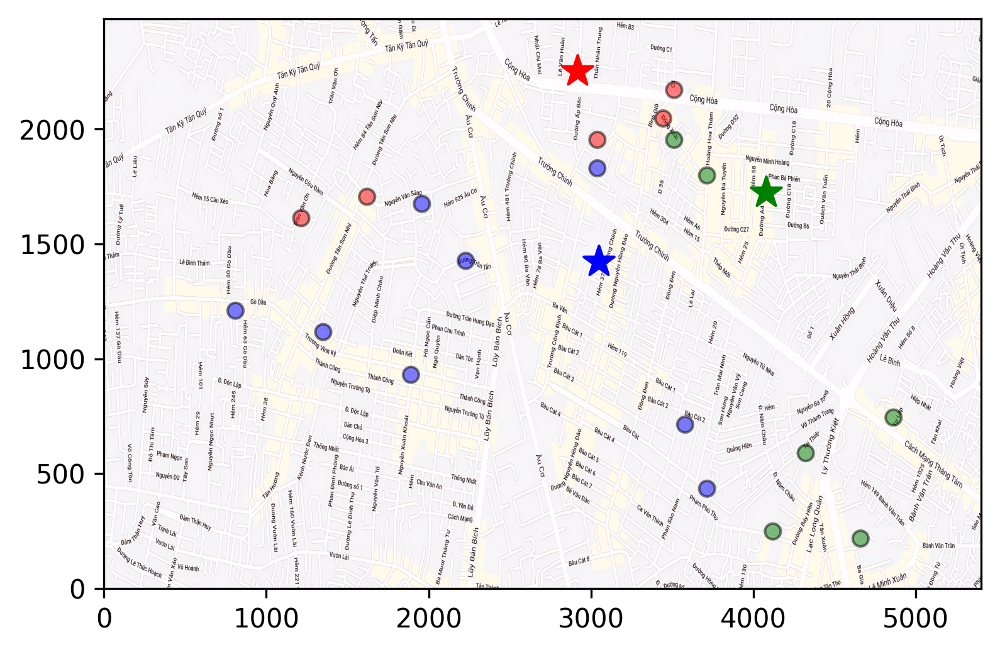

In [113]:
img = plt.imread("map.png")
fig, ax = plt.subplots()
ax.imshow(img, aspect='auto', extent=[0, 5403, 0, 2481])
plt.scatter(df['x'], df['y'], color = df['color'], alpha = 0.5, edgecolor = 'k')
for i in centroids.keys():
    plt.scatter(*centroids[i], color = colmap[i], marker = "*", s = 150)

plt.show()


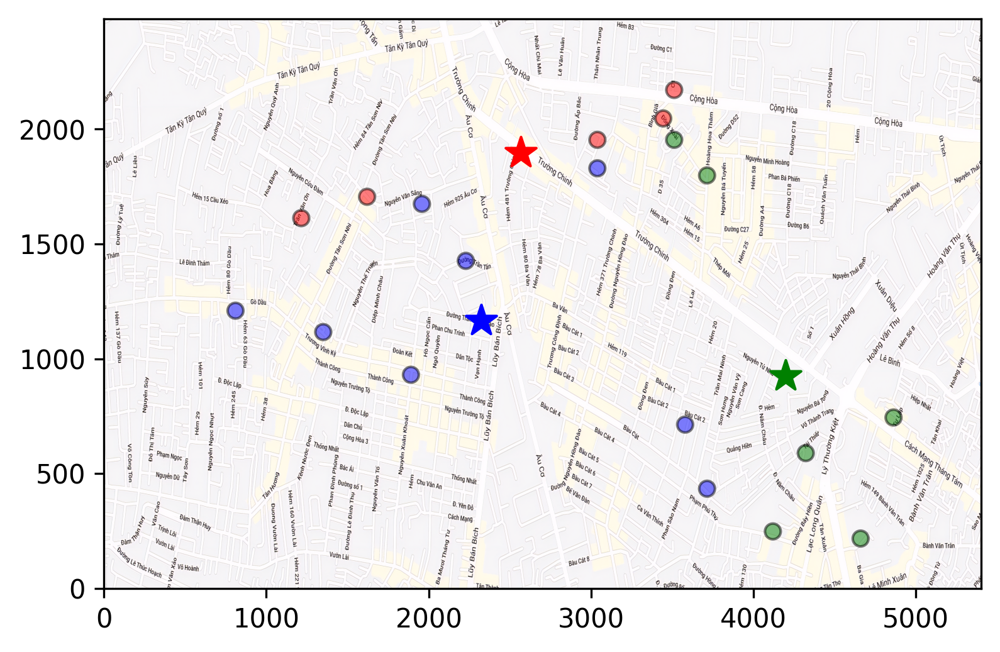

In [114]:
# Update stage
import copy

old_centroids = copy.deepcopy(centroids)

def update(k):
    for i in centroids.keys():
        centroids[i][0] = np.mean(df[df['closest'] == i]['x'])
        centroids[i][1] = np.mean(df[df['closest'] == i]['y'])
    return k

centroids = update(centroids)

img = plt.imread("map.png")
fig, ax = plt.subplots()
ax.imshow(img, aspect='auto', extent=[0, 5403, 0, 2481])
plt.scatter(df['x'], df['y'], color = df['color'], alpha = 0.5, edgecolor='k')
for i in centroids.keys():
    plt.scatter(*centroids[i], color = colmap[i], marker = "*", s = 150)

plt.show()

In [115]:
# Re-assignment stage

df = ass(df, centroids)
df

,x,y,distance_from_1,distance_from_2,distance_from_3,closest,color
0,810.4500,1209.4875,1886.120216,3400.036646,1511.753089,3,b
1,1350.7500,1116.4500,1445.209812,2854.245435,972.158652,3,b
2,1891.0500,930.3750,1179.983813,2307.537039,491.215693,3,b
3,1215.6750,1612.6500,1380.554313,3061.095981,1192.399002,3,b
4,1958.5875,1674.6750,647.552971,2362.048985,624.235694,3,b
5,2228.7375,1426.5750,579.863242,2032.647294,275.831914,3,b
6,1620.9000,1705.6875,964.877279,2693.249266,883.930757,3,b
7,3039.1875,1829.7375,477.660311,1470.500136,976.911270,1,r
8,3039.1875,1953.7875,476.046776,1549.894595,1064.991824,1,r
9,3511.9500,2170.8750,984.122652,1422.375867,1557.242761,1,r


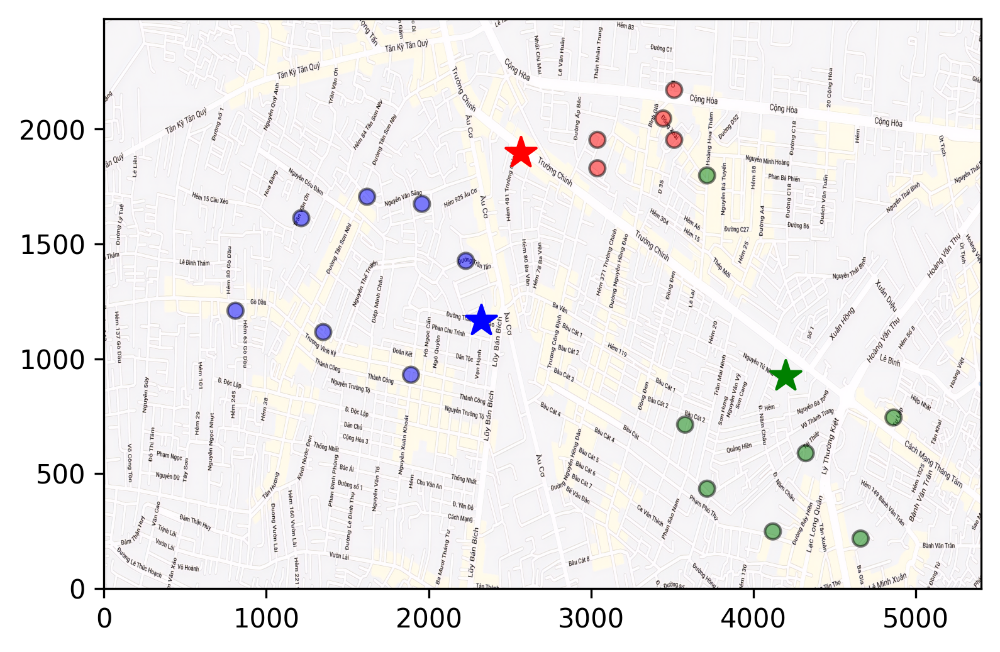

In [116]:
# Plot results
img = plt.imread("map.png")
fig, ax = plt.subplots()
ax.imshow(img, aspect='auto', extent=[0, 5403, 0, 2481])
plt.scatter(df['x'], df['y'], color = df['color'], alpha = 0.5, edgecolor = 'k')
for i in centroids.keys():
    plt.scatter(*centroids[i], color = colmap[i], marker = "*", s = 150)

plt.show()

In [117]:
# Repeating the same process until all assigned categories are no longer changing
while True:
    closest_centroids = df['closest'].copy(deep = True)
    centroids = update(centroids)
    df = ass(df, centroids)
    if closest_centroids.equals(df['closest']):
        break


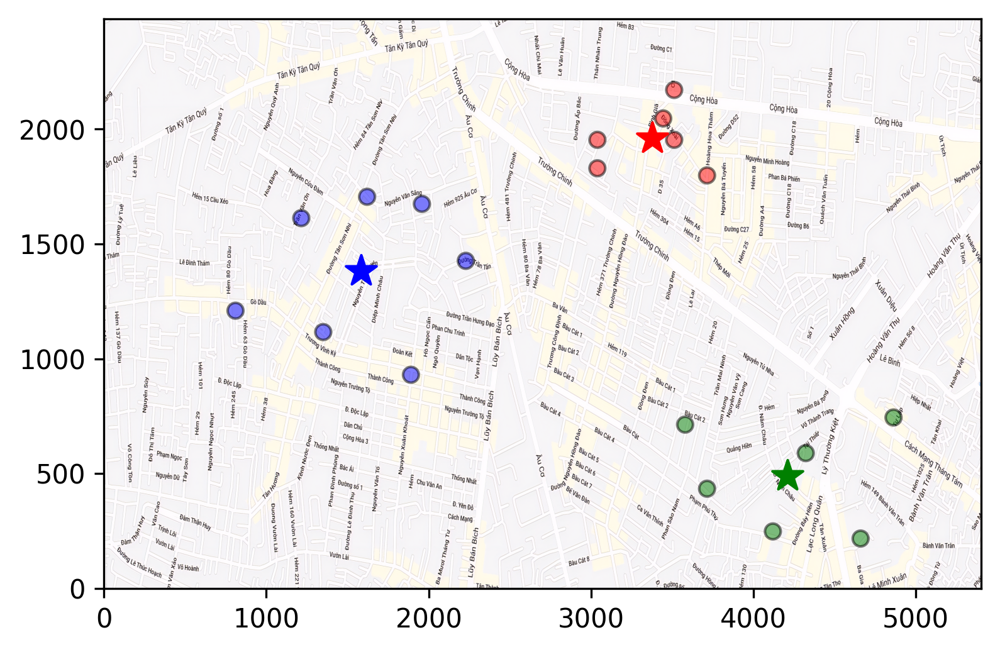

In [118]:
# Final result
img = plt.imread("map.png")
fig, ax = plt.subplots()
ax.imshow(img, aspect='auto', extent=[0, 5403, 0, 2481])
plt.scatter(df['x'], df['y'], color = df['color'], alpha = 0.5, edgecolor = 'k')
for i in centroids.keys():
    plt.scatter(*centroids[i], color = colmap[i], marker = "*", s = 150)

plt.show()